In [ ]:
import os
import zipfile
import shutil
import json
import torch
import torchvision
import numpy as np
from torchvision.transforms import functional as F
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from google.colab import drive
import yaml

In [ ]:
# Step 1: 구글 드라이브 마운트
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Step 2: ZIP 파일 경로 및 압축 해제 경로 설정
zip_path = '/content/dokkaebi VS gaji.v1i.coco.zip'  # 실제 ZIP 파일 경로
extract_path = '/content/plantA'  # 압축 해제할 경로

In [ ]:
# ZIP 파일 해제
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)
    print('ZIP 파일 해제 완료')

ZIP 파일 해제 완료


In [ ]:
# JSON 파일 불러오기 (annotations 변수 정의)
json_file_path = '/content/plantA/train/_annotations.coco.json' # 경로는 실제 JSON 파일 위치에 맞게 수정
with open(json_file_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)

num_classes = len(annotations["categories"]) # 클래스 수 (배경 포함)
print('num_classes:', num_classes)
# 각 클래스 이름 출력
class_names = [category['name'] for category in annotations['categories']]
print('Class names:', class_names)

num_classes: 9
Class names: ['plants', 'dokkaebi_all', 'dokkaebi_flower', 'dokkaebi_fruits', 'dokkaebi_leaves', 'gaji_all', 'gaji_flower', 'gaji_fruits', 'gaji_leaves']


In [ ]:
# 1. YOLOv5 저장소를 클론
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 16953, done.
remote: Counting objects: 100% (148/148), done.
remote: Compressing objects: 100% (100/100), done.
remote: Total 16953 (delta 75), reused 98 (delta 48), pack-reused 16805 (from 1)
Receiving objects: 100% (16953/16953), 15.71 MiB | 19.31 MiB/s, done.
Resolving deltas: 100% (11608/11608), done.
/content/yolov5


In [ ]:
# 2. 종속성을 설치
!pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 48.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 871.8/871.8 kB 37.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 4.2 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0


In [ ]:
# COCO 형식의 JSON 파일 로드
with open('/content/plantA/train/_annotations.coco.json') as f:
    coco_data = json.load(f)

In [ ]:
annotations = coco_data['annotations']
images = {img['id']: img for img in coco_data['images']}

In [ ]:
# 각 이미지에 대해 YOLO 형식의 텍스트 파일 생성
for ann in annotations:
    image_info = images[ann['image_id']]
    width, height = image_info['width'], image_info['height']

    # YOLO 형식 (class_id, x_center, y_center, width, height)
    x_center = (ann['bbox'][0] + ann['bbox'][2] / 2) / width
    y_center = (ann['bbox'][1] + ann['bbox'][3] / 2) / height
    bbox_width = ann['bbox'][2] / width
    bbox_height = ann['bbox'][3] / height

    yolo_ann = f"{ann['category_id']} {x_center} {y_center} {bbox_width} {bbox_height}"
# Replace '/content/drive/MyDrive/plant/train' with the actual path to your images
    image_file_path = f'/content/plantA/train/{image_info["file_name"]}'
    annotation_file_path = image_file_path.replace('.jpg', '.txt')

    with open(annotation_file_path, 'a') as file:
        file.write(yolo_ann + '\n')

In [ ]:
%cat /content/yolov5/models/yolov5s.yaml

# Ultralytics YOLOv5 🚀, AGPL-3.0 license

# Parameters
nc: 80 # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50 # layer channel multiple
anchors:
  - [10, 13, 16, 30, 33, 23] # P3/8
  - [30, 61, 62, 45, 59, 119] # P4/16
  - [116, 90, 156, 198, 373, 326] # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [
    [-1, 1, Conv, [64, 6, 2, 2]], # 0-P1/2
    [-1, 1, Conv, [128, 3, 2]], # 1-P2/4
    [-1, 3, C3, [128]],
    [-1, 1, Conv, [256, 3, 2]], # 3-P3/8
    [-1, 6, C3, [256]],
    [-1, 1, Conv, [512, 3, 2]], # 5-P4/16
    [-1, 9, C3, [512]],
    [-1, 1, Conv, [1024, 3, 2]], # 7-P5/32
    [-1, 3, C3, [1024]],
    [-1, 1, SPPF, [1024, 5]], # 9
  ]

# YOLOv5 v6.0 head
head: [
    [-1, 1, Conv, [512, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 6], 1, Concat, [1]], # cat backbone P4
    [-1, 3, C3, [512, False]], # 13

    [-1, 1, Conv, [256, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 4],

In [ ]:
yaml_content = """
test: /content/plantA/test
train: /content/plantA/train
val: /content/plantA/valid

nc : 9

names : ['plants', 'dokkaebi_all', 'dokkaebi_flower', 'dokkaebi_fruits', 'dokkaebi_leaves', 'gaji_all', 'gaji_flower', 'gaji_fruits', 'gaji_leaves']
"""

file_path = "/content/yolov5/dataset.yaml"

# yaml_content를 해당 경로에 파일로 저장합니다.
with open(file_path, 'w') as file:
    file.write(yaml_content)

print(f"'{file_path}' 경로에 dataset.yaml 파일이 생성되었습니다.")

'/content/yolov5/dataset.yaml' 경로에 dataset.yaml 파일이 생성되었습니다.


In [ ]:
# 데이터셋과 yaml 파일, weights 경로를 설정합니다.
!python train.py --img 640 --batch 16 --epochs 10 --data /content/yolov5/dataset.yaml  --weights yolov5s.pt

2024-09-08 09:07:12.899353: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-08 09:07:12.919236: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-08 09:07:12.925137: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/dataset.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, sing

In [ ]:
# visualization
%load_ext tensorboard
%tensorboard --logdir runs

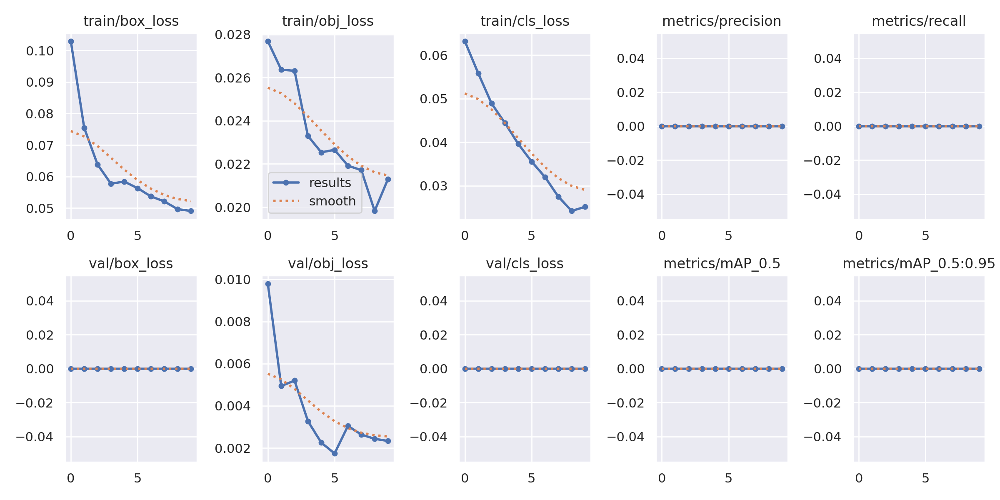

In [ ]:
from IPython.display import Image

# 결과 요약 그래프 보기 (다른 실험일 경우 "exp" 뒤의 숫자를 변경)
Image(filename='/content/yolov5/runs/train/exp7/results.png')

In [ ]:
val_img_path = '/content/plantA/valid'  # 검증 데이터 경로
!python detect.py --weights /content/yolov5/runs/train/exp7/weights/best.pt --img 640 --conf 0.1 --source {val_img_path}

detect: weights=['/content/yolov5/runs/train/exp7/weights/best.pt'], source=/content/plantA/valid, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-365-g12b577c8 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7034398 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/144 /content/plantA/valid/dokkaebi_all_-_-_1074296_jpg.rf.b673ec4b070450d331a9c29892824dca.jpg: 640x640 1 dokkaebi_flower, 11.5ms
image 2/144 /content/plantA/valid/dokkaebi_all_-_-_1074310_jpg.rf.b6237750bf25ee78aae788c1a1f487dc.jpg: 640x640 (no 

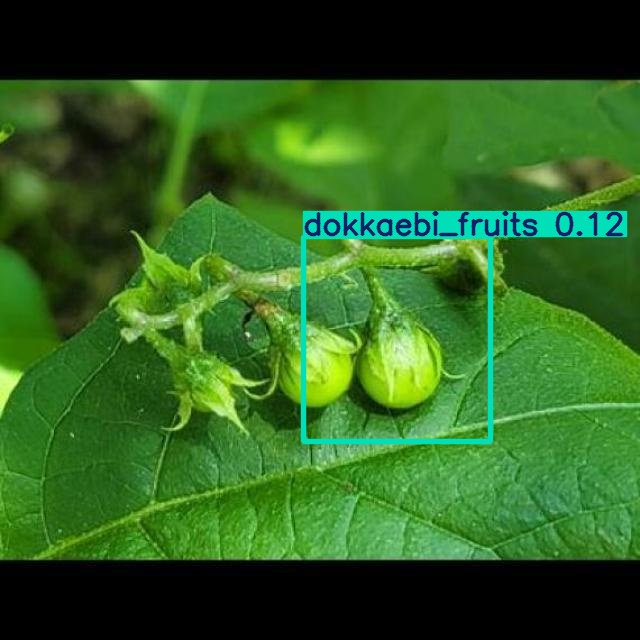

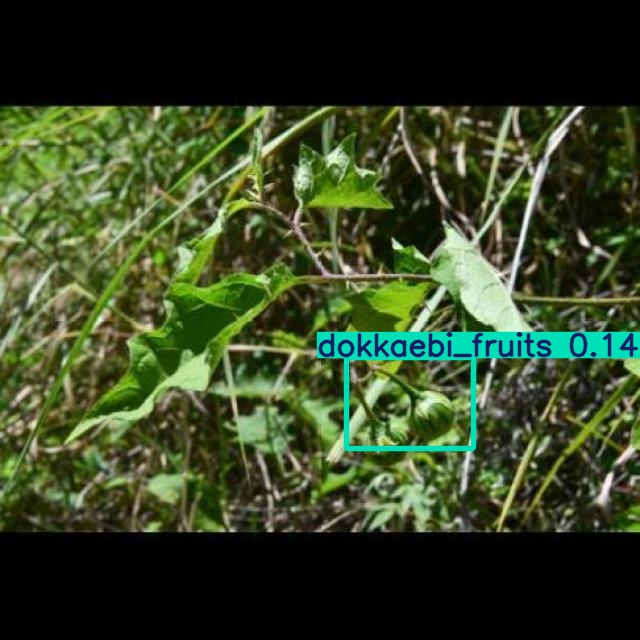

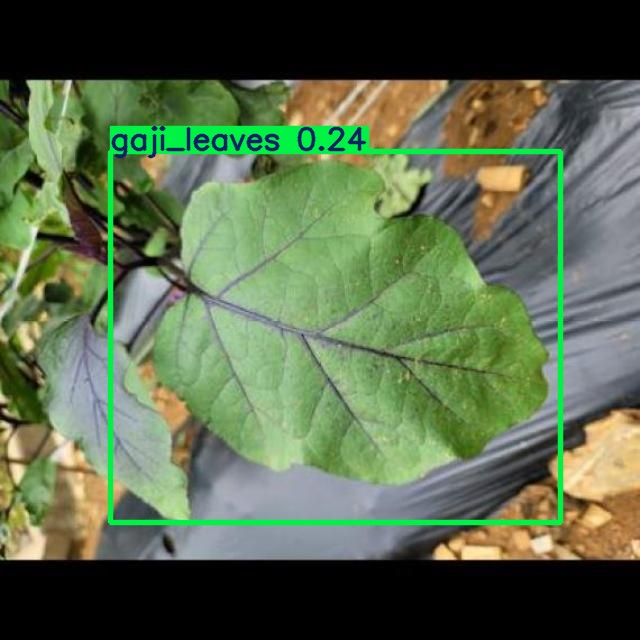

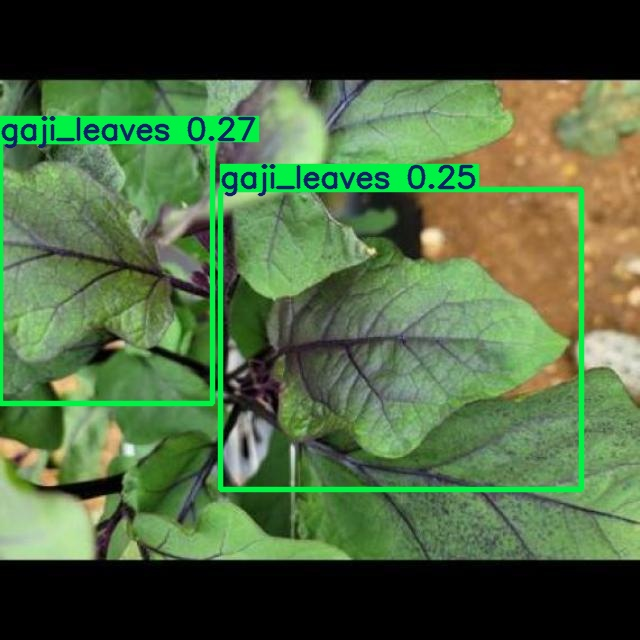

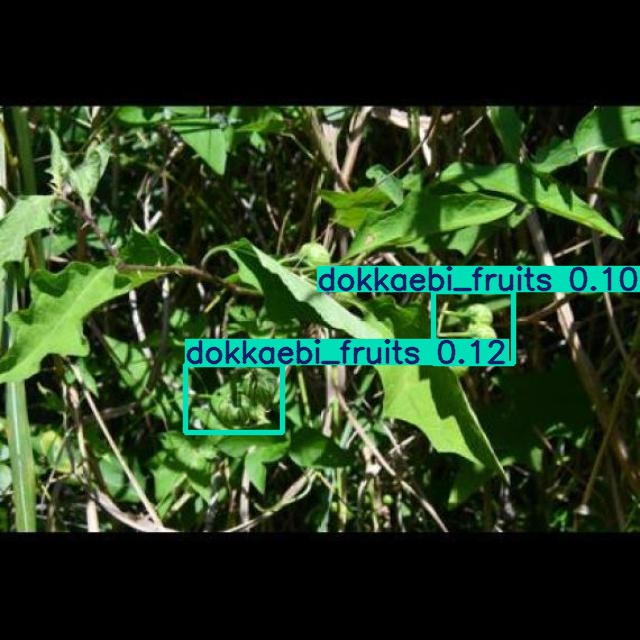

...

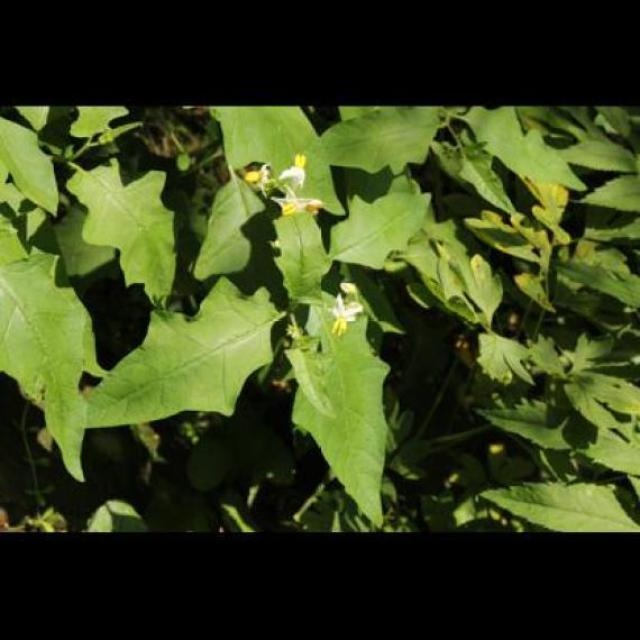

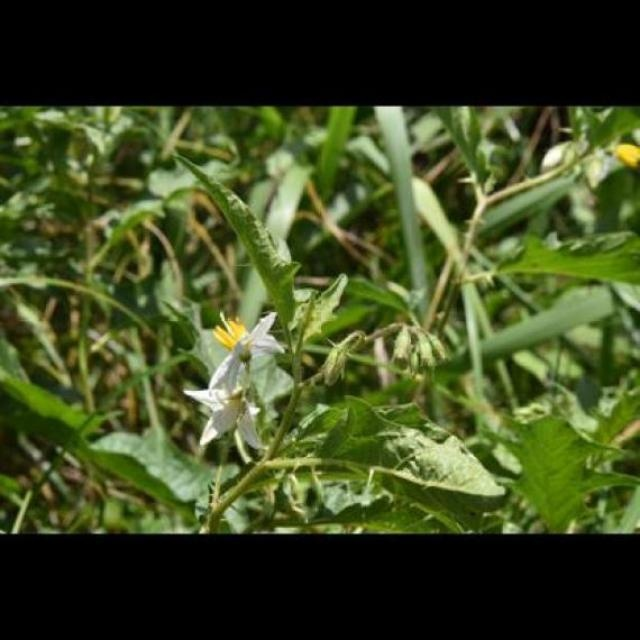

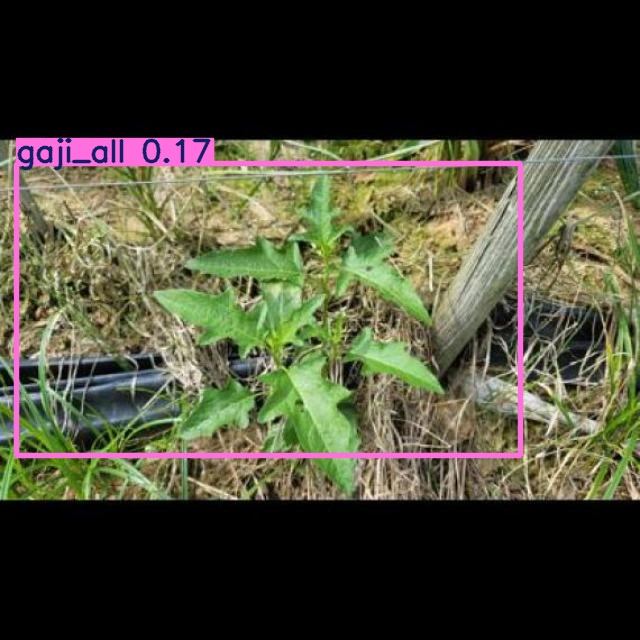

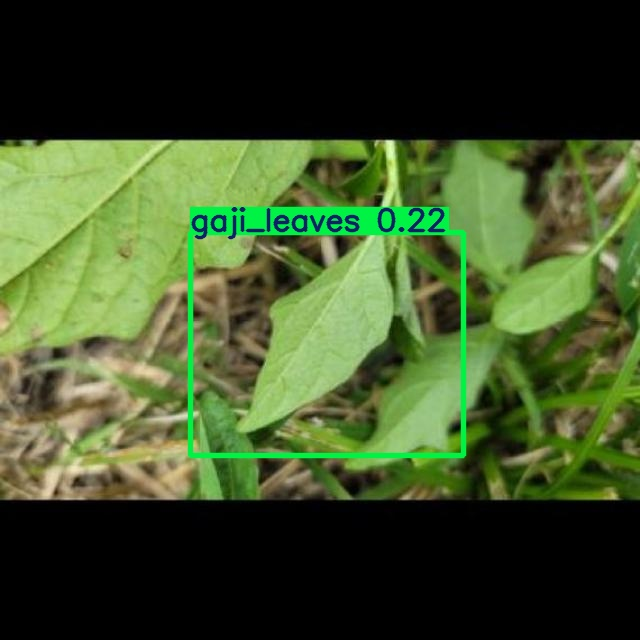

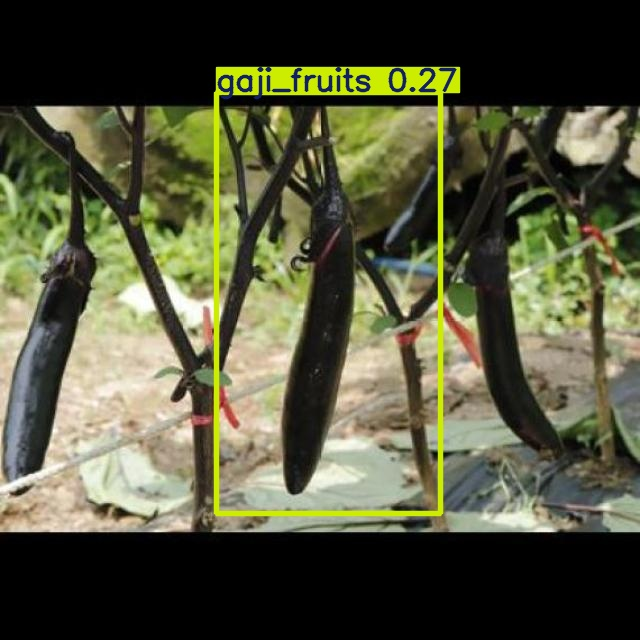

In [ ]:
import os
from IPython.display import Image, display

# 결과 디렉터리 경로 설정 (새로운 실행 시 exp 뒤에 숫자가 붙을 수 있습니다.)
result_dir = '/content/yolov5/runs/detect/exp4'

# 결과 이미지 파일 확인 및 출력
for image_file in os.listdir(result_dir):
    if image_file.endswith(('.jpg', '.png')):  # 이미지 파일만 출력
        display(Image(filename=os.path.join(result_dir, image_file)))

In [ ]:
test_img_path = '/content/plantA/test'  # 테스트 데이터 경로
!python detect.py --weights /content/yolov5/runs/train/exp7/weights/best.pt  --img 640 --conf 0.1 --source {test_img_path}

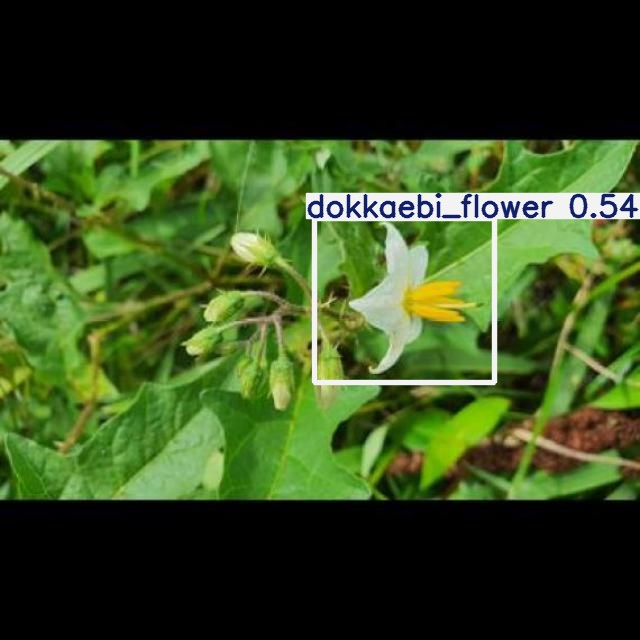

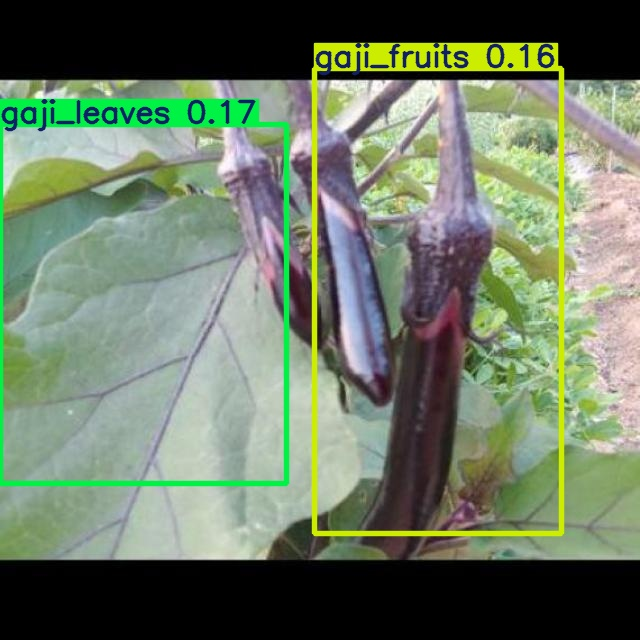

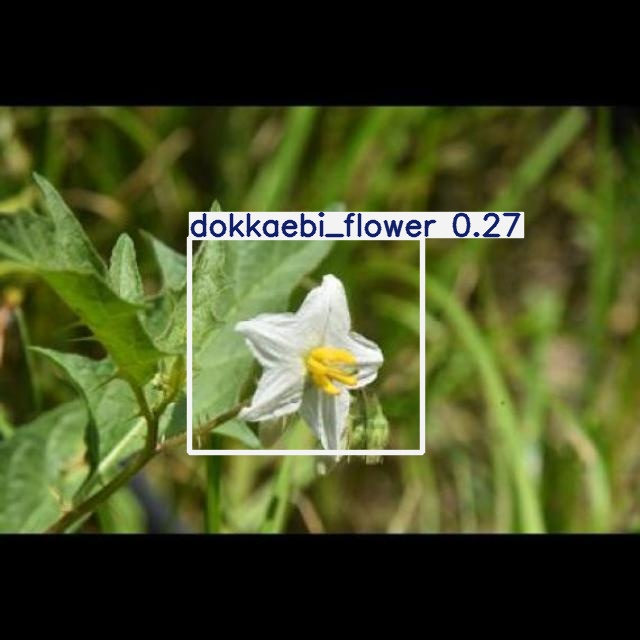

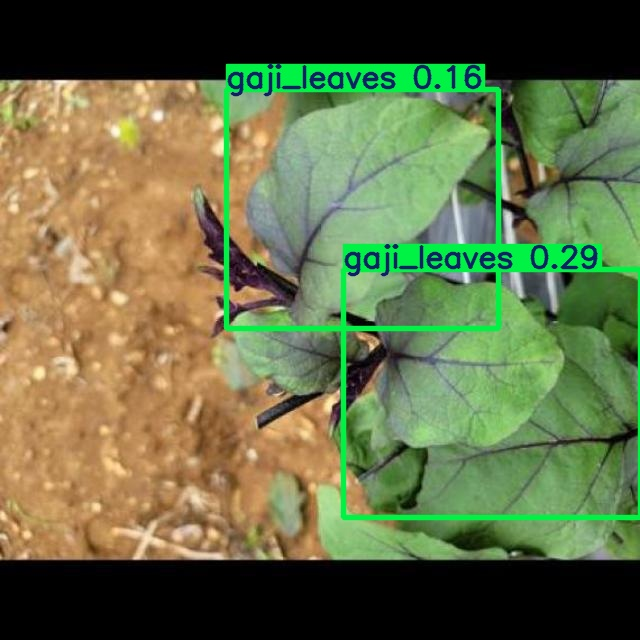

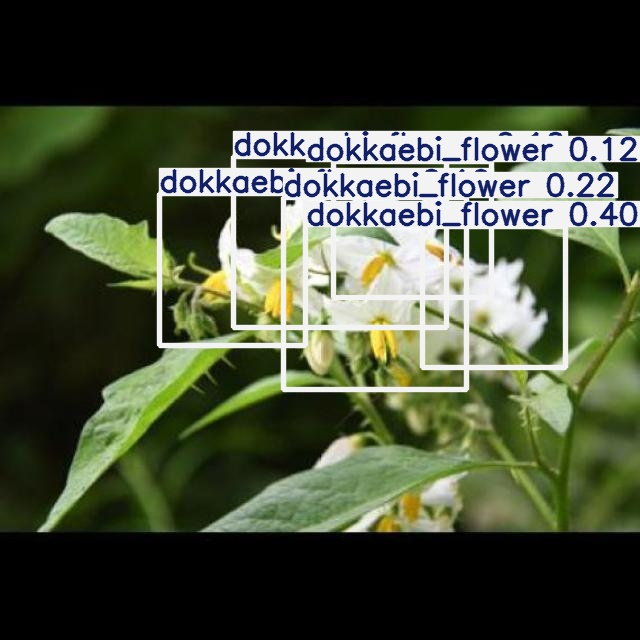

...

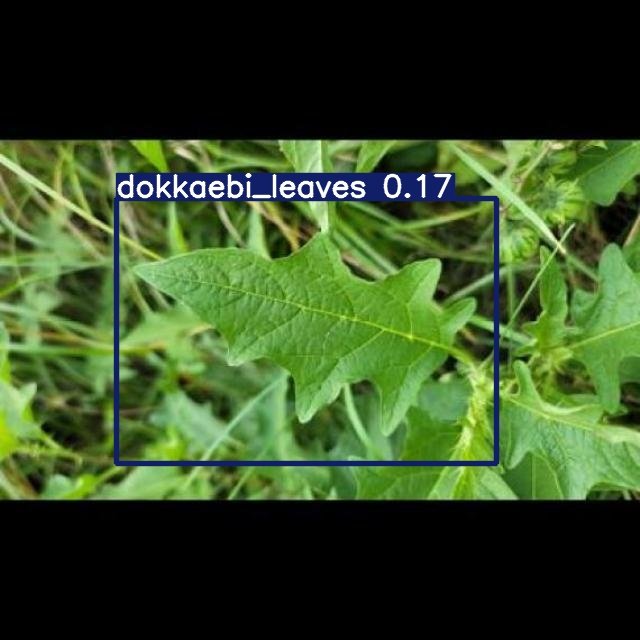

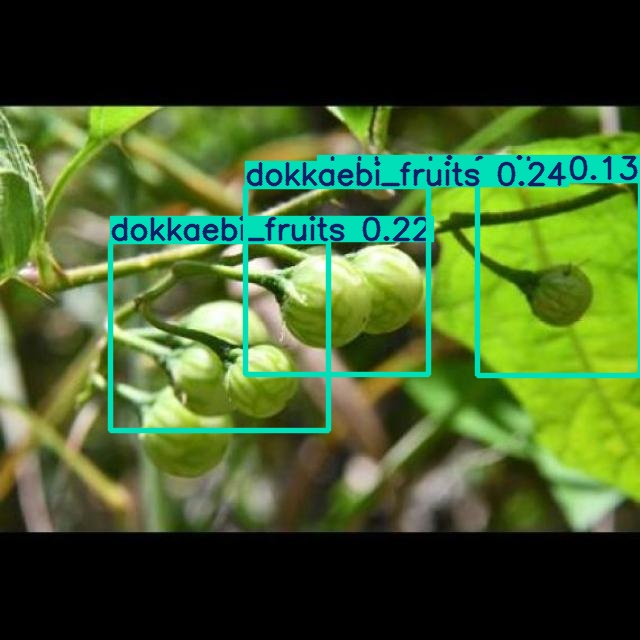

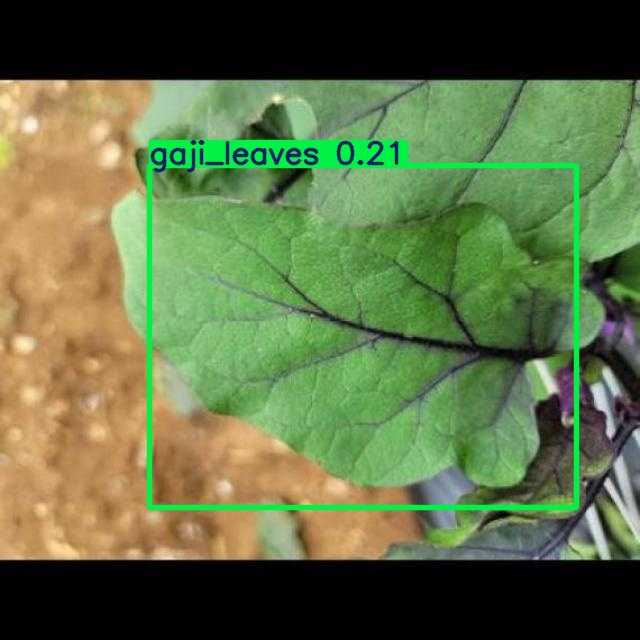

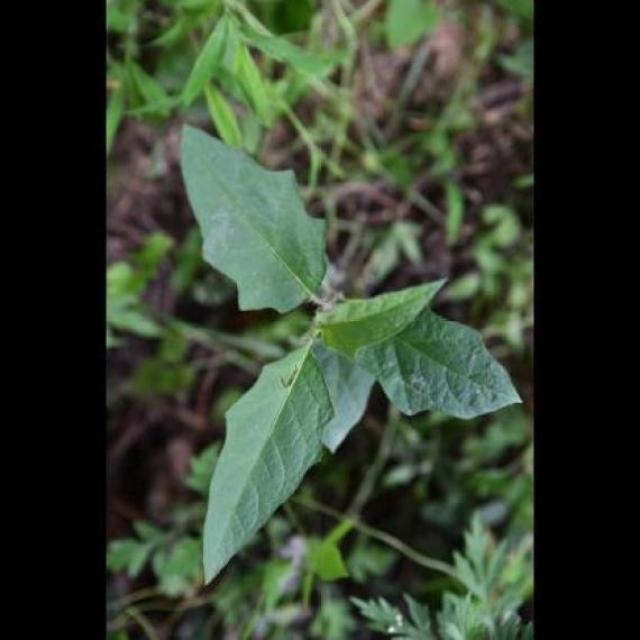

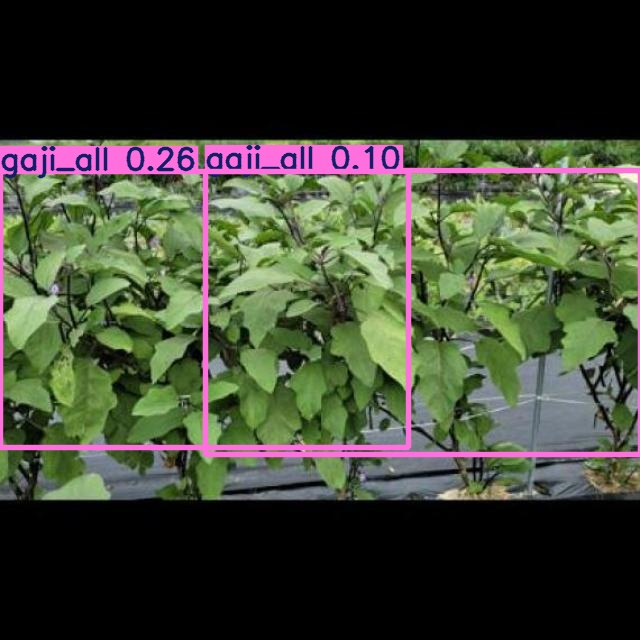

In [ ]:
import os
from IPython.display import Image, display

# 결과 디렉터리 경로 설정 (새로운 실행 시 exp 뒤에 숫자가 붙을 수 있습니다.)
result_dir = '/content/yolov5/runs/detect/exp5'

# 결과 이미지 파일 확인 및 출력
for image_file in os.listdir(result_dir):
    if image_file.endswith(('.jpg', '.png')):  # 이미지 파일만 출력
        display(Image(filename=os.path.join(result_dir, image_file)))